# Explore time series

## Store item demand dataset

In [1]:
# Ignoring warning messages from python
import warnings
warnings.filterwarnings('ignore')

# General use imports
import pandas as pd
import numpy as np

# Visualization imports
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.io as pio
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Modules and data
import acquire
import prep
from datetime import timedelta, datetime

# Module for statistical tests and model evaluation
import statsmodels.api as sm
from statsmodels.tsa.seasonal import DecomposeResult, seasonal_decompose
from statsmodels.tsa.stattools import acf

# Displaying the different templates available in px
pio.templates.default = 'plotly_dark'

In [2]:
# Getting the sales dataset (store item demand dataset)
sales = acquire.get_local_sales()
sales.head()

,item_id,sale_amount,sale_date,sale_id,store_id,item_brand,item_name,item_price,item_upc12,item_upc14,store_address,store_city,store_state,store_zipcode
0,1,13.0,"Tue, 01 Jan 2013 00:00:00 GMT",1,1,Riceland,Riceland American Jazmine Rice,0.84,35200264013,35200264013,12125 Alamo Ranch Pkwy,San Antonio,TX,78253
1,1,11.0,"Wed, 02 Jan 2013 00:00:00 GMT",2,1,Riceland,Riceland American Jazmine Rice,0.84,35200264013,35200264013,12125 Alamo Ranch Pkwy,San Antonio,TX,78253
2,1,14.0,"Thu, 03 Jan 2013 00:00:00 GMT",3,1,Riceland,Riceland American Jazmine Rice,0.84,35200264013,35200264013,12125 Alamo Ranch Pkwy,San Antonio,TX,78253
3,1,13.0,"Fri, 04 Jan 2013 00:00:00 GMT",4,1,Riceland,Riceland American Jazmine Rice,0.84,35200264013,35200264013,12125 Alamo Ranch Pkwy,San Antonio,TX,78253
4,1,10.0,"Sat, 05 Jan 2013 00:00:00 GMT",5,1,Riceland,Riceland American Jazmine Rice,0.84,35200264013,35200264013,12125 Alamo Ranch Pkwy,San Antonio,TX,78253


In [3]:
sales1 = prep.prep_sales_data(sales)
sales1.head()

,item_id,sale_amount,sale_id,store_id,item_brand,item_name,item_price,item_upc12,item_upc14,store_address,store_city,store_state,store_zipcode,month,day_of_week,sales_total
sale_date,,,,,,,,,,,,,,,,
2013-01-01 00:00:00+00:00,1,13.0,1,1,Riceland,Riceland American Jazmine Rice,0.84,35200264013,35200264013,12125 Alamo Ranch Pkwy,San Antonio,TX,78253,"01 Jan, 2013","Tue Jan 01, 2013",10.92
2013-01-01 00:00:00+00:00,12,26.0,211817,7,Mueller,Mueller Sport Care Basic Support Level Medium ...,8.40,74676640211,74676640211,12018 Perrin Beitel Rd,San Antonio,TX,78217,"01 Jan, 2013","Tue Jan 01, 2013",218.40
2013-01-01 00:00:00+00:00,46,27.0,832657,7,Mama Marys,Pizza Sauce,4.65,35457770664,35457770664,12018 Perrin Beitel Rd,San Antonio,TX,78217,"01 Jan, 2013","Tue Jan 01, 2013",125.55
2013-01-01 00:00:00+00:00,12,54.0,213643,8,Mueller,Mueller Sport Care Basic Support Level Medium ...,8.40,74676640211,74676640211,15000 San Pedro Ave,San Antonio,TX,78232,"01 Jan, 2013","Tue Jan 01, 2013",453.60
2013-01-01 00:00:00+00:00,12,35.0,215469,9,Mueller,Mueller Sport Care Basic Support Level Medium ...,8.40,74676640211,74676640211,735 SW Military Dr,San Antonio,TX,78221,"01 Jan, 2013","Tue Jan 01, 2013",294.00


In [4]:
# Displaying the date range of the dataset

print(f'Date Range from: {sales1.index.min()} to: {sales1.index.max()}')
print(f'Shape: {sales1.shape}')

Date Range from: 2013-01-01 00:00:00+00:00 to: 2017-12-31 00:00:00+00:00
Shape: (913000, 16)


In [5]:
# Splitting the data

train = sales1[:'2016']
test = sales1['2017']

In [6]:
# Resampling and creating a dtaframe to plot the split data

mean_train = train.resample('D').sales_total.mean().to_frame().reset_index()
mean_test = test.resample('D').sales_total.mean().to_frame().reset_index()

In [7]:
mean_train

,sale_date,sales_total
0,2013-01-01 00:00:00+00:00,147.68802
1,2013-01-02 00:00:00+00:00,147.14116
2,2013-01-03 00:00:00+00:00,156.33896
3,2013-01-04 00:00:00+00:00,168.93546
4,2013-01-05 00:00:00+00:00,175.24370
...,...,...
1456,2016-12-27 00:00:00+00:00,207.31578
1457,2016-12-28 00:00:00+00:00,210.62788
1458,2016-12-29 00:00:00+00:00,226.44370
1459,2016-12-30 00:00:00+00:00,240.06728


In [8]:
# Plotting the Train and Test side by side

fig = make_subplots(rows=1, cols=2)
fig.add_trace(
    go.Scatter(x=mean_train.sale_date, y=mean_train.sales_total),
    row=1, col=1
)
fig.add_trace(
    go.Scatter(x=mean_test.sale_date, y=mean_test.sales_total),
    row=1, col=2
)
fig.update_layout(height=500, width=700, title_text="Side By Side Subplots of Train and Test")
fig.show()

In [9]:
# Plotting the target variable without time series consideration

# y = train.sales_total
fig = px.histogram(train, x='sales_total', color_discrete_sequence=['indianred'])
fig.show()

In [10]:
# Finding the min and max values of sales_total

train.sales_total.min(), train.sales_total.max()

(0.0, 1903.9899999999998)

In [11]:
# There is only one product that has a 0 sales_total

train['sales_total'].value_counts()[0.0]

1

In [12]:
# Finding that product (sales_total = 0 is due to 0 in sale_amount)

train[train['sales_total'] == 0.0]

,item_id,sale_amount,sale_id,store_id,item_brand,item_name,item_price,item_upc12,item_upc14,store_address,store_city,store_state,store_zipcode,month,day_of_week,sales_total
sale_date,,,,,,,,,,,,,,,,
2014-01-15 00:00:00+00:00,4,0.0,64290,6,Boars Head,Boars Head Sliced White American Cheese - 120 Ct,3.14,208528800007,208528800007,1015 S WW White Rd,San Antonio,TX,78220,"01 Jan, 2014","Wed Jan 15, 2014",0.0


In [13]:
# Plotting a binned sales_total

fig = px.histogram(train, x='sales_total', color_discrete_sequence=['indianred'], nbins=40)
fig.show()

>### Takeaways
        
        - The highest number of purchases in in the group of products between $25 and $75 value
        - Below 1000 count of purchases only occurs for products costing $1075

In [14]:
# Plotting total sales resampled by month

mean_train_month = train.resample('M').sales_total.mean().to_frame().reset_index()
fig = px.line(mean_train_month, x='sale_date', y='sales_total',
              title='Total sales resampled by month',
              color_discrete_sequence=['orange'])
fig.show()

In [15]:
# Average change in sales week-to-week

mean_train_week_to_week = train.resample('W').sales_total.mean().diff().to_frame().reset_index()
mean_train_week_to_week.head()

,sale_date,sales_total
0,2013-01-06 00:00:00+00:00,NaN
1,2013-01-13 00:00:00+00:00,-3.607964
2,2013-01-20 00:00:00+00:00,-2.034483
3,2013-01-27 00:00:00+00:00,0.598663
4,2013-02-03 00:00:00+00:00,9.039631


In [16]:
# Plotting the average change in sales week-to-week

fig = px.line(mean_train_week_to_week, x='sale_date', y='sales_total',
              title='Average week-to-week change in sales',
              color_discrete_sequence=['orange'])
fig.show()

In [17]:
# Average change in sales month-to-month

mean_train_month_to_month = train.resample('M').sales_total.mean().diff().to_frame().reset_index()
mean_train_month_to_month.head()

,sale_date,sales_total
0,2013-01-31 00:00:00+00:00,NaN
1,2013-02-28 00:00:00+00:00,18.517132
2,2013-03-31 00:00:00+00:00,37.769795
3,2013-04-30 00:00:00+00:00,30.278432
4,2013-05-31 00:00:00+00:00,20.203041


In [18]:
# Plotting the average change in sales month-to-month

fig = px.line(mean_train_month_to_month, x='sale_date', y='sales_total',
              title='Average month-to-month change in sales',
              color_discrete_sequence=['orange'])
fig.show()

In [19]:
target = train.sales_total
target.head()

sale_date
2013-01-01 00:00:00+00:00     10.92
2013-01-01 00:00:00+00:00    218.40
2013-01-01 00:00:00+00:00    125.55
2013-01-01 00:00:00+00:00    453.60
2013-01-01 00:00:00+00:00    294.00
Name: sales_total, dtype: float64

In [20]:
# Setting up seasonality

mean_target = target.groupby([target.index.year, target.index.month]).mean().unstack(0)
mean_target

sale_date,2013,2014,2015,2016
sale_date,,,,
1,157.894723,182.410791,191.725206,208.900519
2,176.411855,203.207122,211.589839,227.977512
3,214.181650,244.488991,253.739390,274.367406
4,244.460082,282.786091,295.147608,323.461873
5,264.663123,306.267538,321.813672,342.986382
6,285.261279,324.965376,335.850784,366.316222
7,296.881241,342.849100,359.698008,394.953287
8,266.183375,307.345466,319.435676,340.315372
9,247.237694,281.350430,295.088416,321.333920


In [21]:
# Plotting seasonality

fig = px.line(mean_target,
              title='Sales Seasonality')
fig.show()

>### There seems to be a seasonlity in sales
        - What types of products are sold between June and August, in November, at the end of December and beginning of January?
        
>### To find out and/or confirm that there is a seasonality or an autocorrelation in the dataset, I will plot a lag of the sales

<AxesSubplot:xlabel='y(t)', ylabel='y(t + 52)'>

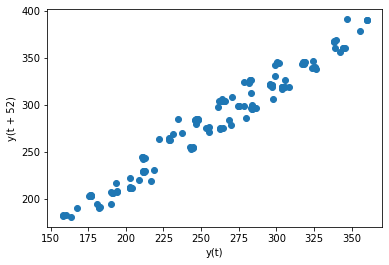

In [22]:
# Plotting the lag of sales, resampled by week and lagging by a year

pd.plotting.lag_plot(train.sales_total.resample('W').mean(), lag=52)

In [38]:
# # x_values = dates if dates is not None else np.arange(len(result.observed))

# def plot_autocorrelation(series, plot_pacf=False, title:str='Autocorrelation'):
#     acf(series.dropna(), alpha=0.05)
#     lower_y = corr_array[1][:,0] - corr_array[0]
#     upper_y = corr_array[1][:,1] - corr_array[0]
#     fig == go.Figure()
#     fig.add_scatter(x=train.sale_date, y=train.sales_total,
#                             mode='markers',
#                             line_color='#3f3f3f')
#     fig.show()

In [40]:
# Figure = seasonal_decompose(train.sales_total, model='additive', period=25)
# fig = plot_seasonal_decomposition(decomposition, dates=train.sale_date)
# fig.show()

<AxesSubplot:xlabel='Lag', ylabel='Autocorrelation'>

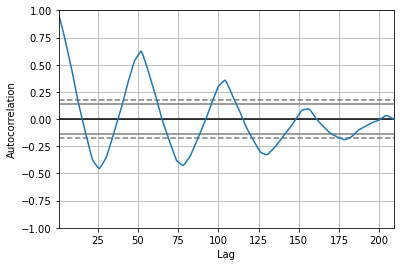

In [26]:
# Plotting the lag of sales, resampled by month and lagging by a year

pd.plotting.autocorrelation_plot(train.sales_total.resample('W').mean())

>### There is clearly a seasonality at every 25 weeks and an autocorrelation within the data which means certain periods can be targeted with specific marketing activities to match customers' needs
>### I will plot a seasonal decomposition graph to display the noise from seasonality and trend

In [27]:
sm.tsa.seasonal_decompose(target.resample('W').mean())

In [28]:
mean_train_month.head()

,sale_date,sales_total
0,2013-01-31 00:00:00+00:00,157.894723
1,2013-02-28 00:00:00+00:00,176.411855
2,2013-03-31 00:00:00+00:00,214.181650
3,2013-04-30 00:00:00+00:00,244.460082
4,2013-05-31 00:00:00+00:00,264.663123


In [29]:
'''
This function takes in a statistical model:
1.the seasonal decomposition using moving averages:
a pd Series of the value to plot (df.column_name, pd.Series, np.array),
the model or type of seasonal component ('additive' or 'multiplicative'),
and a period determining the amount of lag (integer),
2.the dates of the dataset as a Series (df.column_name, pd.Series) or
the length of the observed variable (np.arange(len(result.observed)))
'''

def plot_seasonal_decomposition(result:DecomposeResult, dates:pd.Series=None, title:str='Seasonal Decomposition'):
    x_values = dates if dates is not None else np.arange(len(result.observed))
    return (
        make_subplots(
            rows=4,
            cols=1,
            subplot_titles=['Observed', 'Trend', 'Seasonal', 'Residuals'],
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.observed, mode='lines', name='Observed'),
            row=1,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.trend, mode='lines', name='Trend'),
            row=2,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.seasonal, mode='lines', name='Seasonal'),
            row=3,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.resid, mode='markers', name='Residual'),
            row=4,
            col=1,
        )
        .update_layout(
            height=900, title=f'<b>{title}</b>', margin={'t':100}, title_x=0.5, showlegend=False
        )
    )

In [30]:
mean_train_week = train.resample('W').sales_total.mean().to_frame().reset_index()
mean_train_week

,sale_date,sales_total
0,2013-01-06 00:00:00+00:00,163.589167
1,2013-01-13 00:00:00+00:00,159.981203
2,2013-01-20 00:00:00+00:00,157.946720
3,2013-01-27 00:00:00+00:00,158.545383
4,2013-02-03 00:00:00+00:00,167.585014
...,...,...
204,2016-12-04 00:00:00+00:00,263.768997
205,2016-12-11 00:00:00+00:00,228.559894
206,2016-12-18 00:00:00+00:00,229.298643
207,2016-12-25 00:00:00+00:00,229.231000


In [ ]:
mean_train_week.sale_date.de

In [31]:
# Plotting the seasonal decomposition with a resampled data by week and a lag of 25 weeks

decomposition = seasonal_decompose(mean_train_week.sales_total, model='additive', period=25)
fig = plot_seasonal_decomposition(decomposition, dates=mean_train_week.sale_date)
fig.show()

In [32]:
# Plotting the seasonal decomposition with a resampled data by week and a lag of 25 weeks

decomposition = seasonal_decompose(mean_train_month.sales_total, model='additive', period=6)
fig = plot_seasonal_decomposition(decomposition, dates=mean_train_month.sale_date)
fig.show()

In [33]:
train.head(1)

,item_id,sale_amount,sale_id,store_id,item_brand,item_name,item_price,item_upc12,item_upc14,store_address,store_city,store_state,store_zipcode,month,day_of_week,sales_total
sale_date,,,,,,,,,,,,,,,,
2013-01-01 00:00:00+00:00,1,13.0,1,1,Riceland,Riceland American Jazmine Rice,0.84,35200264013,35200264013,12125 Alamo Ranch Pkwy,San Antonio,TX,78253,"01 Jan, 2013","Tue Jan 01, 2013",10.92


In [42]:
mean_train_month.loc['Jun, 2013':'August, 2013'].sales_total.sum().plot(figsize=(17, 10))

AttributeError: 'numpy.float64' object has no attribute 'plot'

## Opsd dataset

In [35]:
opsd = acquire.get_opsd_germany()
opsd.head()

,Date,Consumption,Wind,Solar,Wind_and_Solar
0,2006-01-01,1069.184,NaN,NaN,NaN
1,2006-01-02,1380.521,NaN,NaN,NaN
2,2006-01-03,1442.533,NaN,NaN,NaN
3,2006-01-04,1457.217,NaN,NaN,NaN
4,2006-01-05,1477.131,NaN,NaN,NaN
